# Этот ноутбук для запуска модели.

**Ссылки на датасеты, которые использовались для обучения:**

https://drive.google.com/file/d/1O1eIuXX1hlGsV7qx4eSkjH231q7G1by1/view?usp=drive_link

https://drive.google.com/drive/folders/1IyPiYJUp-KtOoa-Hsm922VU3aCcidjjz?usp=drive_link
 

In [1]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import timm

class SwinEncoder(nn.Module):
    def __init__(self, model_name='swin_tiny_patch4_window7_224', pretrained=True):
        super().__init__()
        self.backbone = timm.create_model(
            model_name,
            pretrained=pretrained,
            features_only=True
        )

    def forward(self, x):
        features = self.backbone(x)
        features = [f.permute(0, 3, 1, 2).contiguous() for f in features]
        return features

class DetailBranch(nn.Module):
    def __init__(self, in_ch=384):
        super().__init__()
        self.conv = nn.Sequential(
            nn.Conv2d(in_ch, 256, 3, padding=1), nn.BatchNorm2d(256), nn.ReLU(inplace=True),
            nn.Conv2d(256, 256, 3, padding=1), nn.BatchNorm2d(256), nn.ReLU(inplace=True)
        )
    def forward(self, x):
        return self.conv(x)

class CrossAttentionModule(nn.Module):
    def __init__(self, sem_channels=512, det_channels=256):
        super().__init__()
        self.query_conv = nn.Conv2d(sem_channels, sem_channels // 8, 1)
        self.key_conv = nn.Conv2d(det_channels, sem_channels // 8, 1)
        self.value_conv = nn.Conv2d(det_channels, det_channels, 1)
        self.gamma = nn.Parameter(torch.zeros(1))
        self.output_conv = nn.Sequential(
            nn.Conv2d(det_channels, det_channels, 3, padding=1),
            nn.BatchNorm2d(det_channels),
            nn.ReLU(inplace=True)
        )

    def forward(self, sem_features, det_features):
        batch_size, _, h_sem, w_sem = sem_features.size()
        _, _, h_det, w_det = det_features.size()

        sem_resized = F.interpolate(sem_features, size=(h_det, w_det), mode='bilinear', align_corners=False)

        query = self.query_conv(sem_resized)
        key = self.key_conv(det_features)
        value = self.value_conv(det_features)

        query = query.view(batch_size, -1, h_det * w_det).permute(0, 2, 1)
        key = key.view(batch_size, -1, h_det * w_det)
        value = value.view(batch_size, -1, h_det * w_det)

        energy = torch.bmm(query, key)
        attention = torch.softmax(energy, dim=-1)
        out = torch.bmm(value, attention.permute(0, 2, 1))
        out = out.view(batch_size, -1, h_det, w_det)

        out = self.gamma * out + det_features
        out = self.output_conv(out)
        return out

class MattingDecoder(nn.Module):
    def __init__(self, in_channels=512 + 256):
        super().__init__()

        self.up1 = nn.Sequential(
            nn.Conv2d(in_channels, 256, 3, padding=1),
            nn.BatchNorm2d(256),
            nn.ReLU(inplace=True),
            nn.Upsample(scale_factor=2, mode='bilinear', align_corners=False)
        )

        self.up2 = nn.Sequential(
            nn.Conv2d(256 + 128, 128, 3, padding=1),
            nn.BatchNorm2d(128),
            nn.ReLU(inplace=True),
            nn.Upsample(scale_factor=2, mode='bilinear', align_corners=False)
        )

        self.up3 = nn.Sequential(
            nn.Conv2d(128 + 64, 64, 3, padding=1),
            nn.BatchNorm2d(64),
            nn.ReLU(inplace=True),
            nn.Upsample(scale_factor=2, mode='bilinear', align_corners=False)
        )

        self.final_conv = nn.Sequential(
            nn.Conv2d(64, 32, 3, padding=1),
            nn.BatchNorm2d(32),
            nn.ReLU(inplace=True),
            nn.Conv2d(32, 1, 1)
        )

    def forward(self, sem, det, low_level_feat2, low_level_feat1, out_size):
        x = torch.cat([sem, det], dim=1) 
        x = self.up1(x)

        x = torch.cat([x, low_level_feat2], dim=1) 
        x = self.up2(x)

        x = torch.cat([x, low_level_feat1], dim=1) 
        x = self.up3(x)

        x = F.interpolate(x, size=out_size, mode='bilinear', align_corners=False)
        x = self.final_conv(x)
        return torch.sigmoid(x)

class SOTAMattingNet(nn.Module):
    def __init__(self, encoder_name='swin_tiny_patch4_window7_224', pretrained=True):
        super().__init__()
        self.encoder = SwinEncoder(encoder_name, pretrained)

        self.sem_proj = nn.Sequential(
            nn.Conv2d(768, 512, 1),
            nn.BatchNorm2d(512),
            nn.ReLU(inplace=True)
        )

        self.detail = DetailBranch(in_ch=384)
        self.attn = CrossAttentionModule(sem_channels=512, det_channels=256)

        self.low_level_proj1 = nn.Conv2d(96, 64, 1)
        self.low_level_proj2 = nn.Conv2d(192, 128, 1)

        self.decoder = MattingDecoder(in_channels=512 + 256)

    def forward(self, img):

        orig_size = img.shape[2:]

        img_224 = F.interpolate(
            img, size=(224, 224),
            mode='bilinear', align_corners=False
        )

        f1, f2, f3, f4 = self.encoder(img_224)
        # f1: [B, 96, 56, 56]
        # f2: [B, 192, 28, 28]
        # f3: [B, 384, 14, 14]
        # f4: [B, 768, 7, 7]

        sem = self.sem_proj(f4)
        sem = F.interpolate(sem, size=f3.shape[2:], mode='bilinear', align_corners=False)

        det = self.detail(f3)
        det = self.attn(sem, det)

        low1 = self.low_level_proj1(f1)
        low2 = self.low_level_proj2(f2)

        alpha_224 = self.decoder(
            sem, det, low2, low1,
            out_size=(224, 224)
        )

        alpha = F.interpolate(
            alpha_224,
            size=orig_size,
            mode='bilinear',
            align_corners=False
        )

        return alpha

loss_fn = nn.MSELoss()

# ------------------------------------
# Inference + PNG→base64 submission
# ------------------------------------
def make_submission(model, images, filenames, device="cuda"):
    model.to(device).eval()
    rows = []
    with torch.no_grad():
        for img, fname in zip(images, filenames):
            inp = img.unsqueeze(0).to(device)
            pred = model(inp)[0,0]
            pred_np = (pred.cpu().numpy()*255).astype('uint8')

            # PNG + base64
            pil_mask = Image.fromarray(pred_np, mode="L")
            buf = io.BytesIO()
            pil_mask.save(buf, format="PNG")
            b64 = base64.b64encode(buf.getvalue()).decode("utf-8")
            rows.append({"filename": fname, "image_utf": b64})

    return rows

/usr/local/lib/python3.12/dist-packages/pydantic/_internal/_generate_schema.py:2249: UnsupportedFieldAttributeWarning: The 'repr' attribute with value False was provided to the `Field()` function, which has no effect in the context it was used. 'repr' is field-specific metadata, and can only be attached to a model field using `Annotated` metadata or by assignment. This may have happened because an `Annotated` type alias using the `type` statement was used, or if the `Field()` function was attached to a single member of a union type.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/pydantic/_internal/_generate_schema.py:2249: UnsupportedFieldAttributeWarning: The 'frozen' attribute with value True was provided to the `Field()` function, which has no effect in the context it was used. 'frozen' is field-specific metadata, and can only be attached to a model field using `Annotated` metadata or by assignment. This may have happened because an `Annotated` type alias using the `type` 

In [2]:
import torch
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms
from PIL import Image
import numpy as np
import io
import base64
import pandas as pd
from pathlib import Path
import cv2

class TestDataset(Dataset):
    def __init__(self, image_dir, size=1024):
        self.image_dir = Path(image_dir)
        self.files = list(self.image_dir.glob("*.png")) + list(self.image_dir.glob("*.jpg"))
        self.size = size
        self.transform = transforms.Compose([
            transforms.Resize((self.size, self.size)),
            transforms.ToTensor()
        ])

    def __len__(self):
        return len(self.files)

    def __getitem__(self, idx):
        file = self.files[idx]
        img = Image.open(file).convert("RGB")
        img_tensor = self.transform(img)
        return img_tensor, file.stem

# -------------------------------
# Guided Filter для улучшения альфа-канала
# -------------------------------
def guided_filter_soft_alpha(mask: np.ndarray, image: np.ndarray, radius=15, eps=1e-3):
    
    mask_f = mask.astype(np.float32) / 255.0
    guide = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY).astype(np.float32) / 255.0

    mean_I = cv2.boxFilter(guide, ddepth=-1, ksize=(radius, radius))
    mean_p = cv2.boxFilter(mask_f, ddepth=-1, ksize=(radius, radius))

    corr_I = cv2.boxFilter(guide * guide, ddepth=-1, ksize=(radius, radius))
    corr_Ip = cv2.boxFilter(guide * mask_f, ddepth=-1, ksize=(radius, radius))

    var_I = corr_I - mean_I * mean_I
    cov_Ip = corr_Ip - mean_I * mean_p
    a = cov_Ip / (var_I + eps)
    b = mean_p - a * mean_I
    mean_a = cv2.boxFilter(a, ddepth=-1, ksize=(radius, radius))
    mean_b = cv2.boxFilter(b, ddepth=-1, ksize=(radius, radius))
    q = mean_a * guide + mean_b

    refined_alpha = np.clip(q, 0, 1)
    return (refined_alpha * 255).astype(np.uint8)


device = "cuda" if torch.cuda.is_available() else "cpu"

model = SOTAMattingNet() 
state_dict = torch.load("/kaggle/input/model-to-upgrade/best_matting_model_improved.pth", map_location=device)
model.load_state_dict(state_dict)
model.to(device)
model.eval()

test_dataset = TestDataset("/kaggle/input/test-data-ecom-tech/orig_1024", size=1024)
test_loader = DataLoader(test_dataset, batch_size=1, shuffle=False)

rows = []

with torch.no_grad():
    for img_tensor, fname in test_loader:
        img_tensor = img_tensor.to(device)
        pred = model(img_tensor)
        pred_np = (pred[0, 0].cpu().numpy() * 255).astype(np.uint8)
        img_np = (img_tensor[0].cpu().numpy().transpose(1, 2, 0) * 255).astype(np.uint8)
        refined_mask_np = guided_filter_soft_alpha(pred_np, img_np, radius=20, eps=1e-3)
        pil_mask = Image.fromarray(refined_mask_np, mode="L")
        buf = io.BytesIO()
        pil_mask.save(buf, format="PNG")
        b64 = base64.b64encode(buf.getvalue()).decode("utf-8")

        rows.append({"filename": fname[0], "image_utf": b64})

submission_csv_path = Path("submission.csv")
pd.DataFrame(rows).to_csv(submission_csv_path, index=False)
print(f"Saved submission CSV with encoded images to {submission_csv_path}")

model.safetensors:   0%|          | 0.00/114M [00:00<?, ?B/s]

/tmp/ipykernel_17/571352589.py:77: DeprecationWarning: 'mode' parameter is deprecated and will be removed in Pillow 13 (2026-10-15)
  pil_mask = Image.fromarray(refined_mask_np, mode="L")


Saved submission CSV with encoded images to submission.csv


# Декодировщик для просмотра результата.


Decoded 100 images to decoded_masks


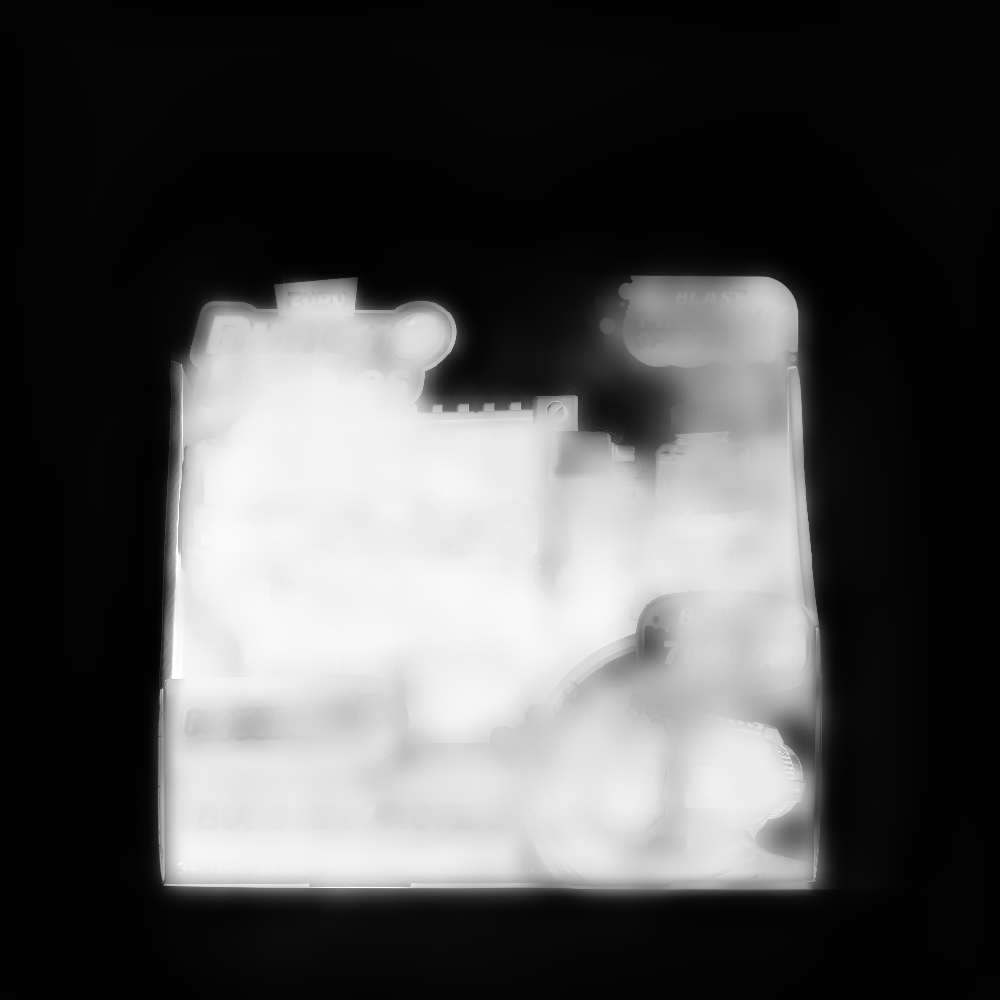

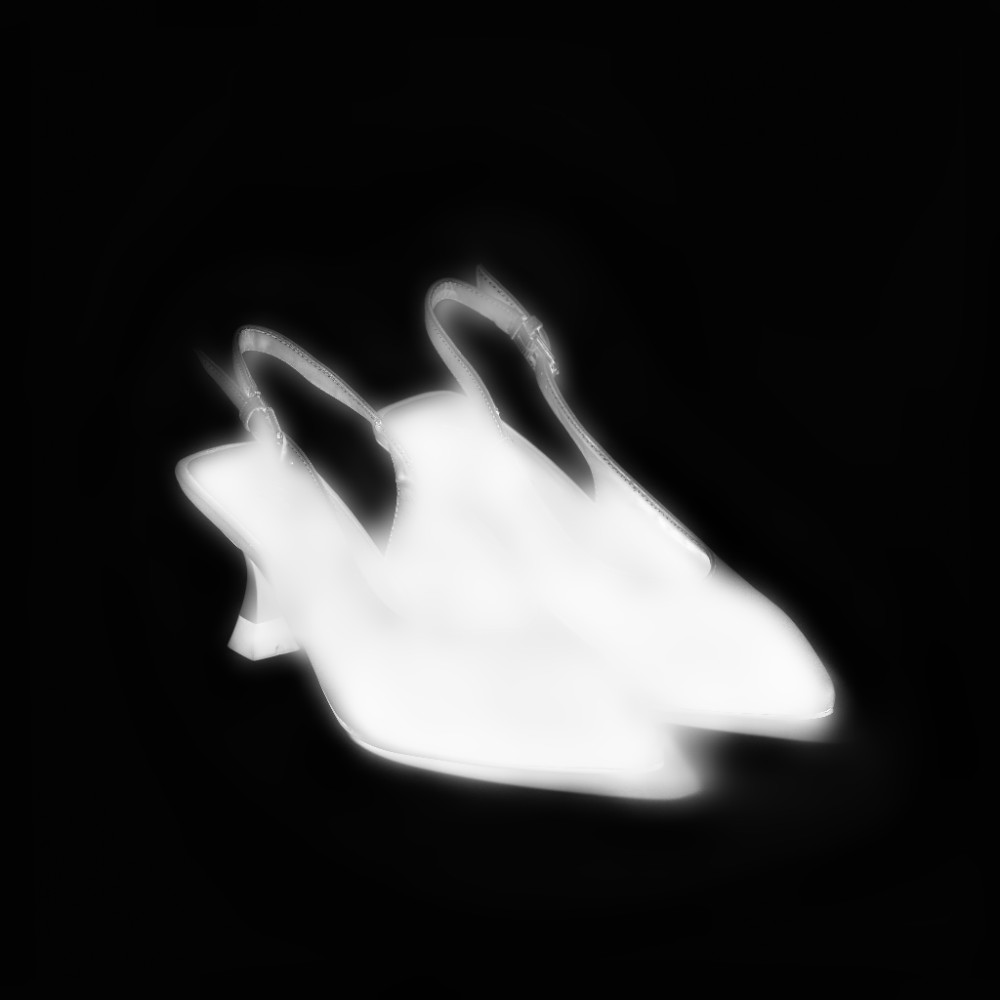

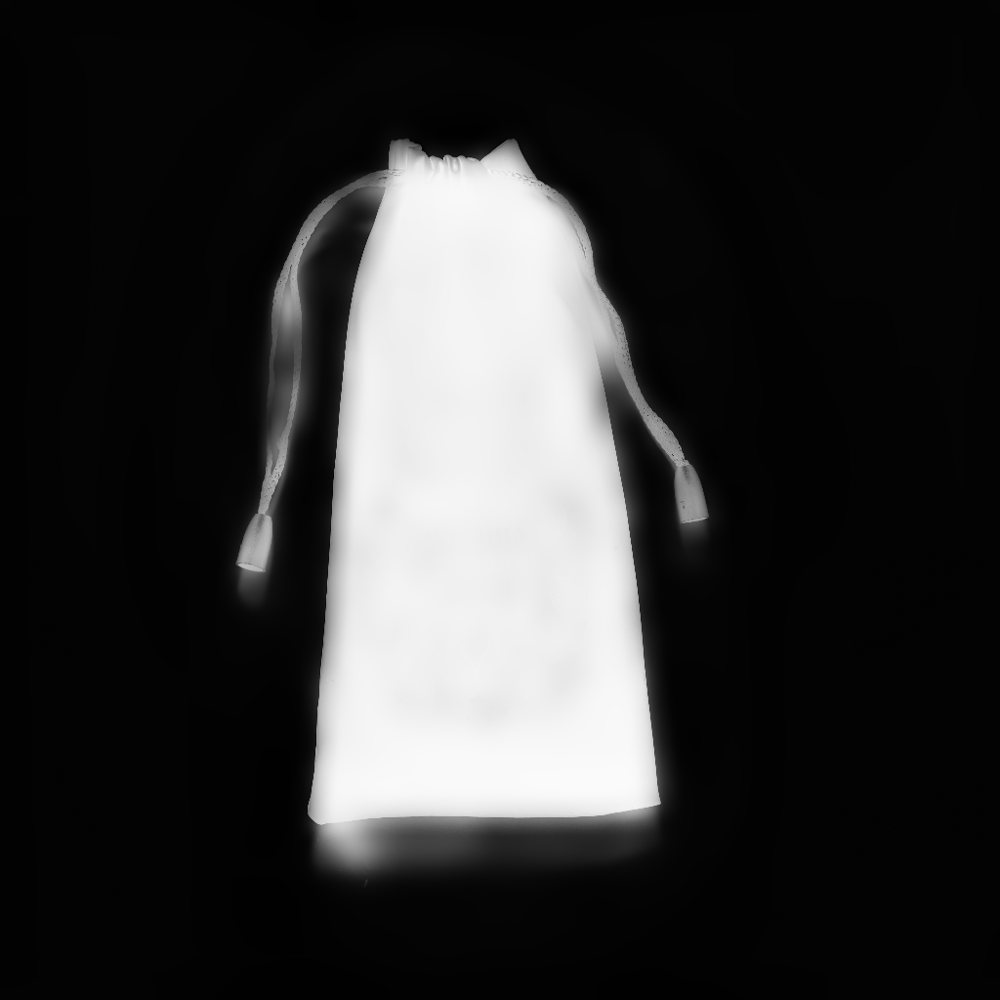

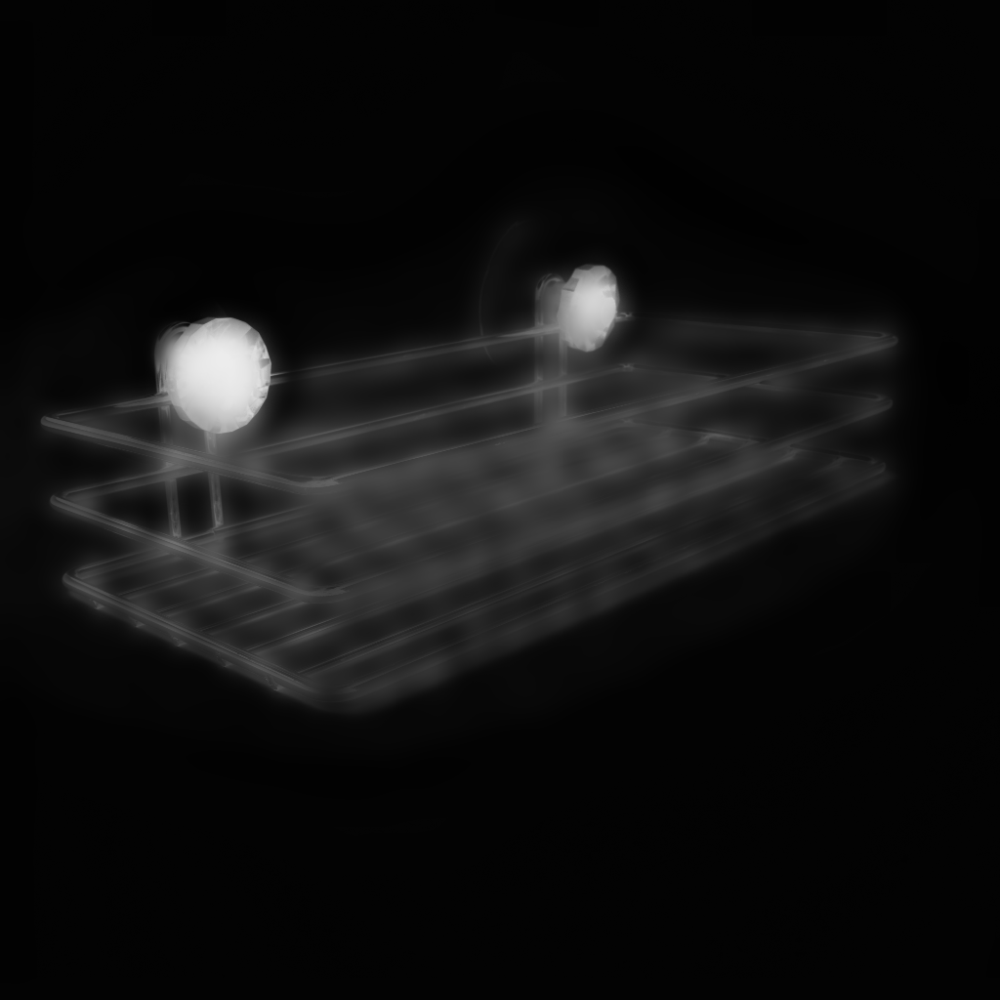

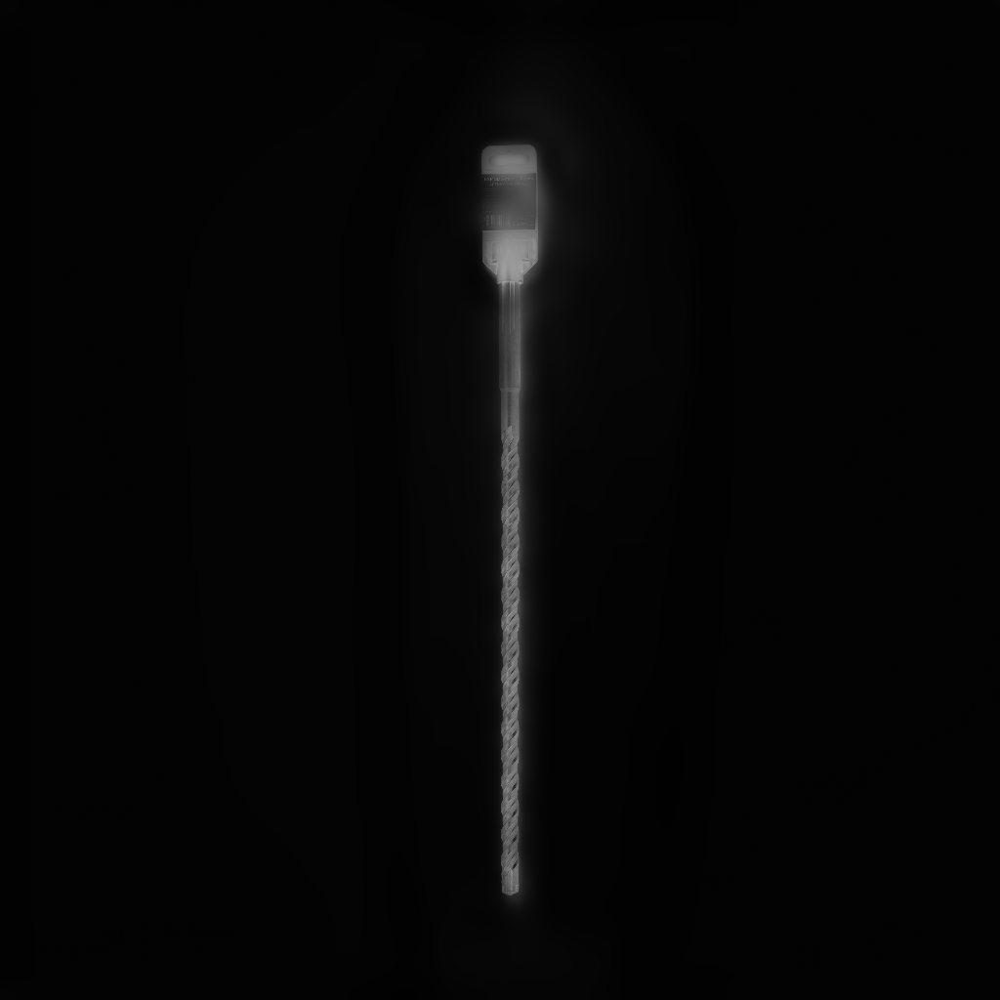

...

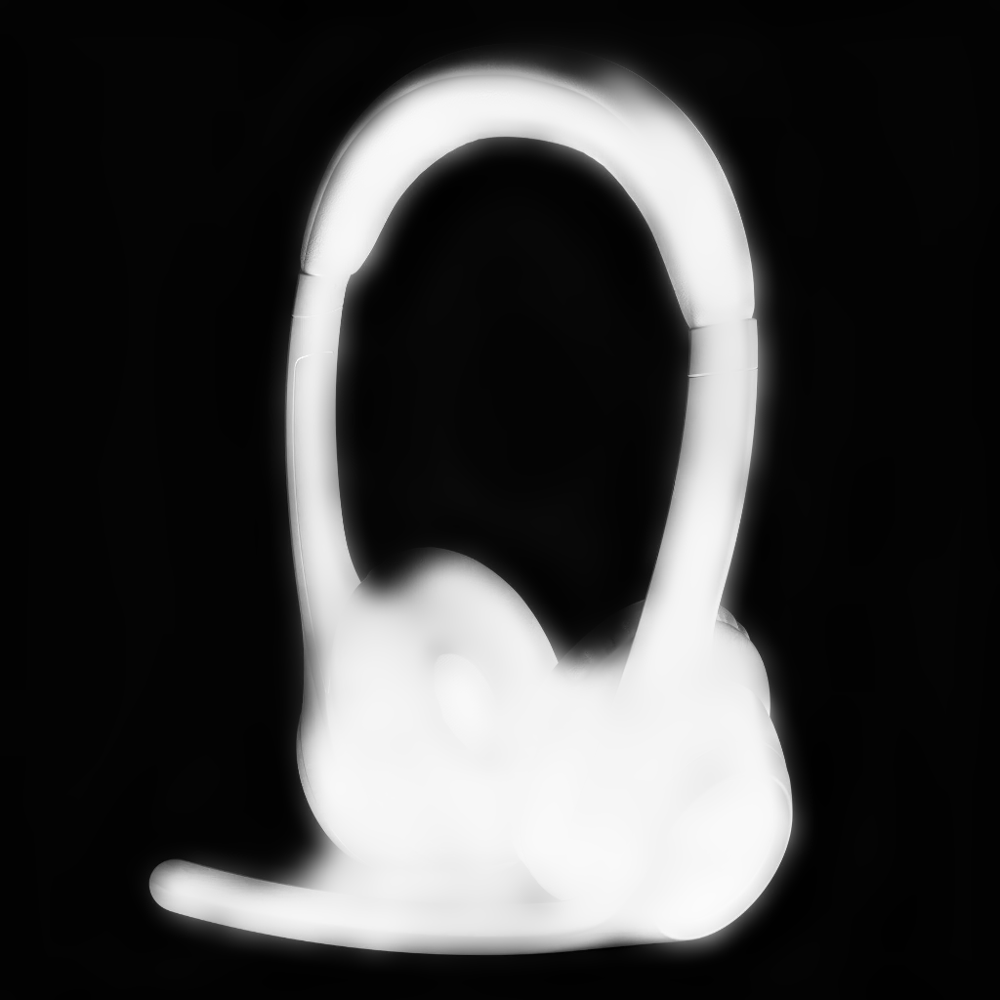

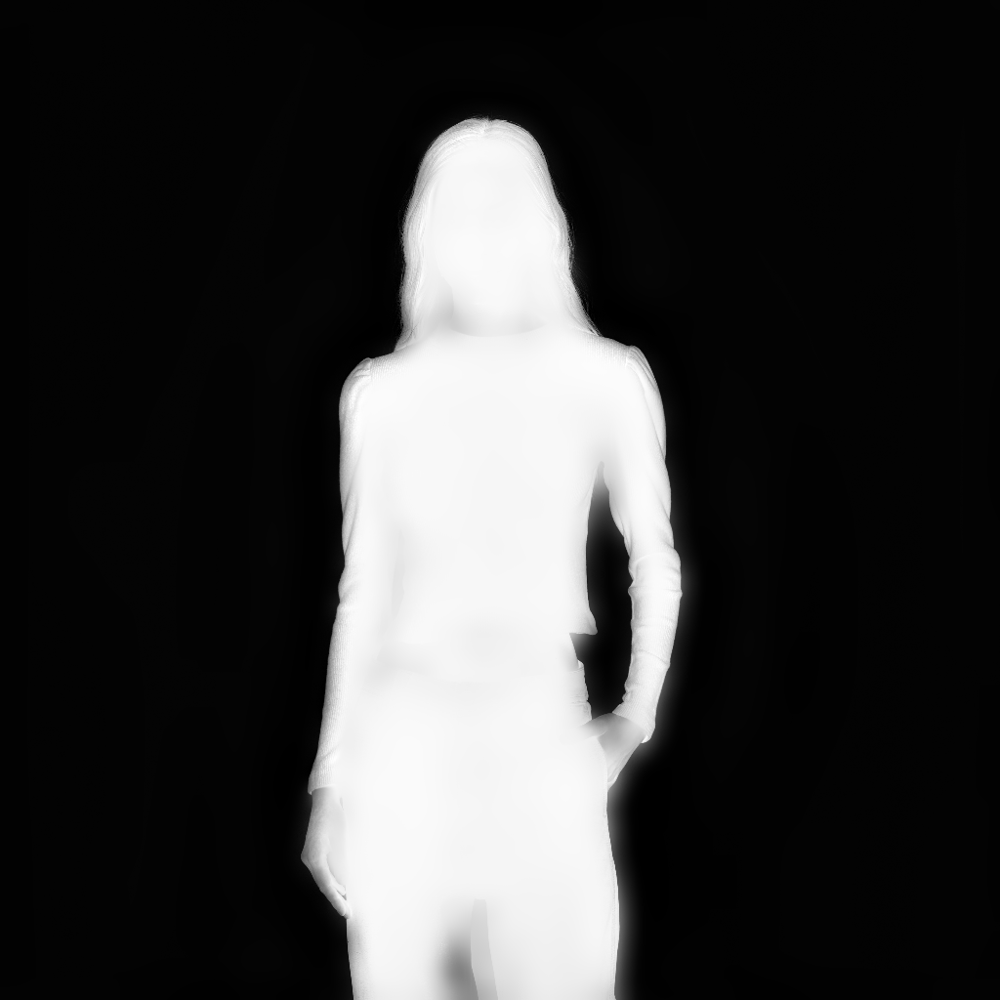

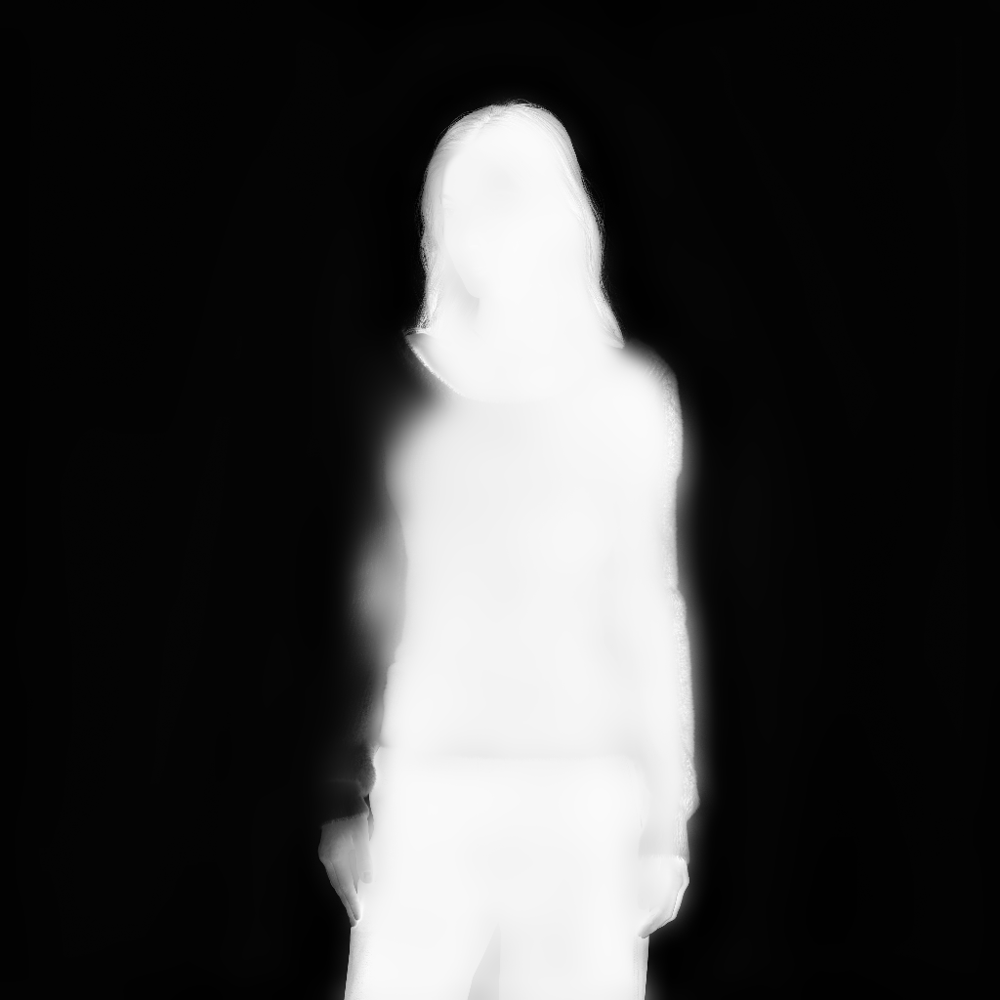

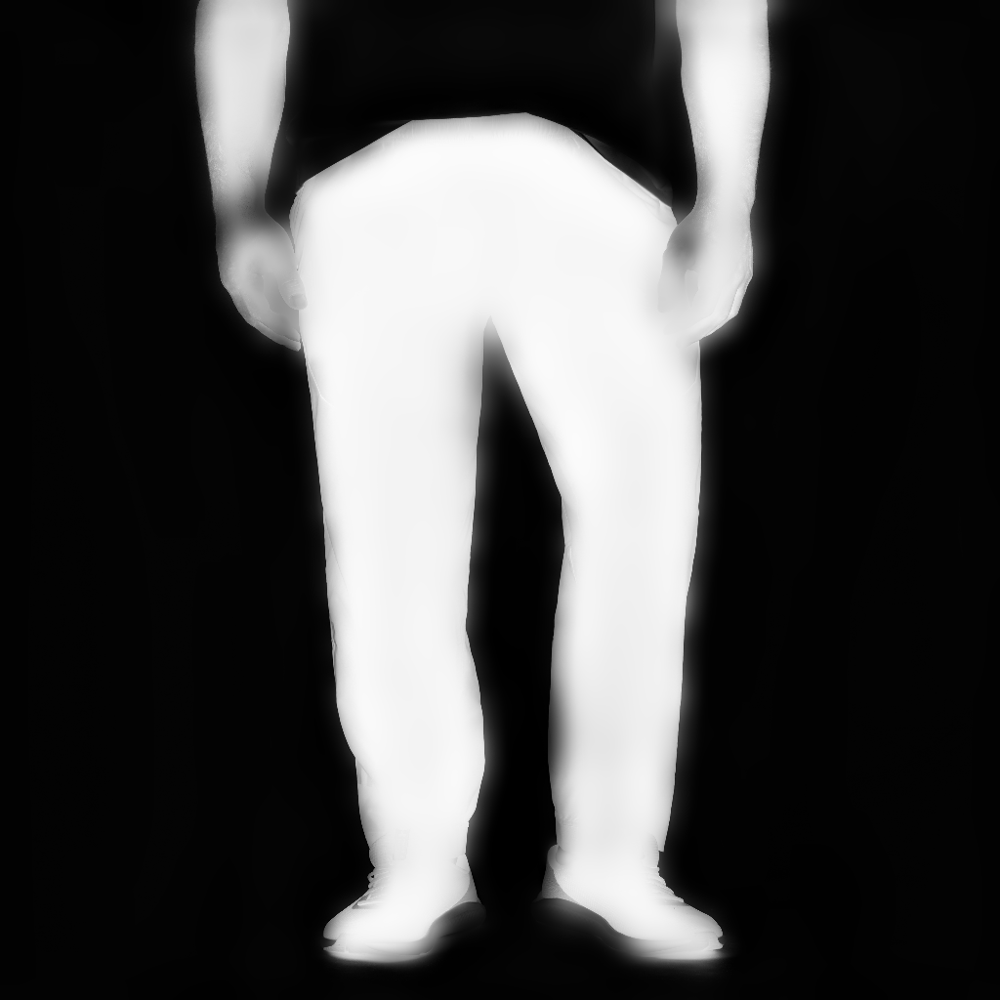

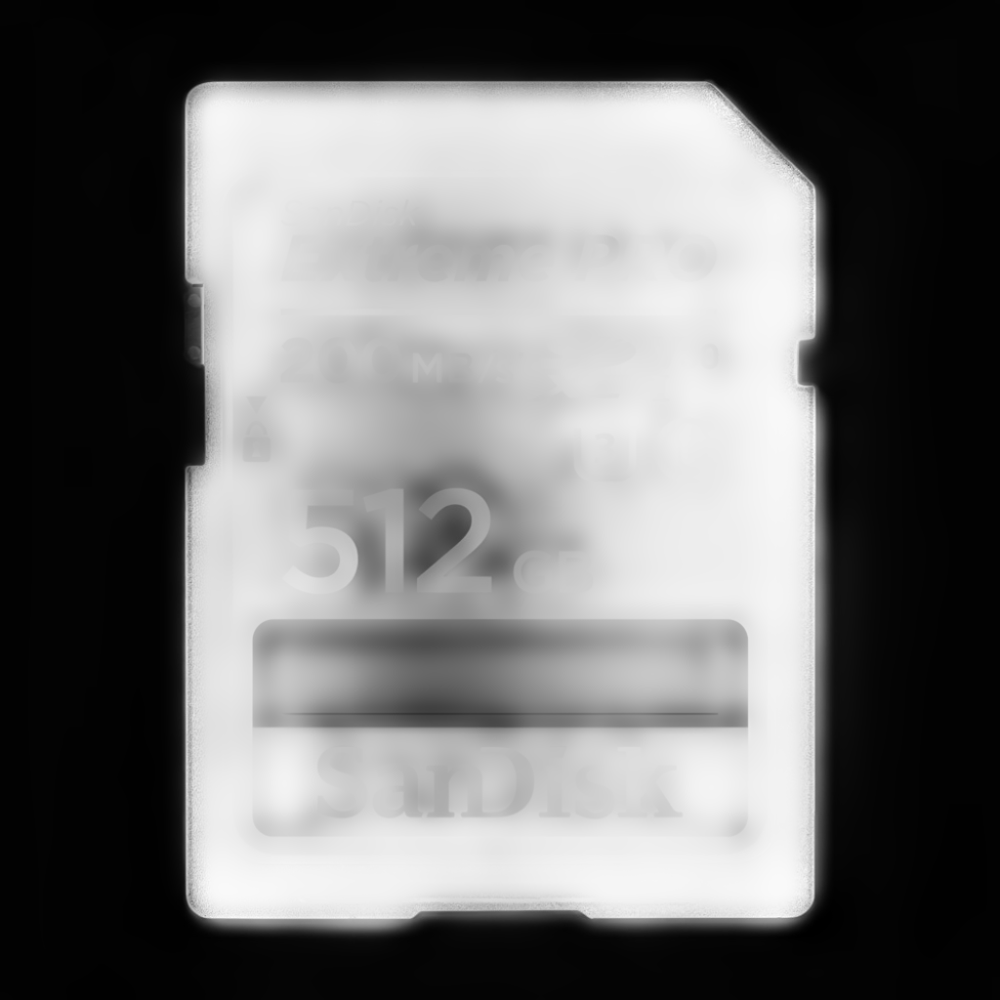

In [3]:
import pandas as pd
import base64
from PIL import Image
import io
from pathlib import Path

# Путь к CSV
submission_csv_path = Path("/kaggle/working/submission.csv")

# Папка, куда сохранять раскодированные PNG
decoded_dir = Path("decoded_masks")
decoded_dir.mkdir(exist_ok=True)

# Загружаем CSV
df = pd.read_csv(submission_csv_path)

# Проходим по всем строкам
for idx, row in df.iterrows():
    filename = row['filename']
    b64_str = row['image_utf']

    # Декодируем из base64
    img_bytes = base64.b64decode(b64_str)
    im = Image.open(io.BytesIO(img_bytes))

    # Сохраняем PNG
    save_path = decoded_dir / f"{filename}.png"
    im.save(save_path)

print(f"Decoded {len(df)} images to {decoded_dir}")
from IPython.display import display

# Показать первые 5 изображений
for file in list(decoded_dir.glob("*.png"))[:100]:
    im = Image.open(file)
    display(im)